In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import tensorflow as tf
import os
import matplotlib.pyplot as plt
import cv2
from tensorflow.keras import layers
# Input data files are available in the read-only "../input/" directory
# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

# Introduction 

## Problem

This notebook is meant to build a model to transfer photos to Monet style paintings with generative adversial network(GAN). 

GAN architecture is an approach to training a model for image synthesis that is comprised of two models: a generator model and a discriminator model. The generator is responsible for generating plausible images from the dataset whereas the discriminator wants to classify if an image is a real image or a fake(generated) image. Clearly, this is a zero-sum game, which means how much one model gain is how much another model loss. Eventually, we hope our generator will generate high quality images that the discriminator can no longer pick up fake images from true images.

For this particular task, we hope our GAN generator will generate photos that are very "Monet-ish", and our GAN discriminator can also do a good job on identifying Monet style.

## Data

Our data contains real Monet painting with dimension(300, 256, 256, 3) and photoes need to be convert to Monet style with dimension(7028, 256, 256, 3). In other words, we have 300 painting and 7028 photoes, each image has 3 color channels and size of 256 pixel * 256 pixel. 

Note, Kaggle provides all images in two formats: jpg and tfrec. In this notebook, I will use tfrec format as this is a brand new format for me, and I can play with it.

# Exploratory Data Analysis (EDA)

## Load Data

In [2]:
in_dir = '/kaggle/input/gan-getting-started'
out_dir = '/kaggle/working'

monet_tfrec_names = tf.io.gfile.listdir(f'{in_dir}/monet_tfrec')
monet_jpg_names = tf.io.gfile.listdir(f'{in_dir}/monet_jpg')
photo_tfrec_names = tf.io.gfile.listdir(f'{in_dir}/photo_tfrec')
photo_jpg_names = tf.io.gfile.listdir(f'{in_dir}/photo_jpg')

print(f'There are {len(monet_tfrec_names)} Monet TFRecord collections')
print(f'There are {len(monet_jpg_names)} Monet jpgs in total')
print(f'There are {len(photo_tfrec_names)} photo TFRecord collections')
print(f'There are {len(photo_jpg_names):,} photo jpgs in total')
print()
print(f'Sample of what the TFRecord files look like: {monet_tfrec_names}')

There are 5 Monet TFRecord collections
There are 300 Monet jpgs in total
There are 20 photo TFRecord collections
There are 7,038 photo jpgs in total

Sample of what the TFRecord files look like: ['monet12-60.tfrec', 'monet16-60.tfrec', 'monet08-60.tfrec', 'monet04-60.tfrec', 'monet00-60.tfrec']


In [3]:
ex = tf.train.Example()
ex.ParseFromString(
    next(iter(tf.data.TFRecordDataset(f'{in_dir}/monet_tfrec/{monet_tfrec_names[0]}').take(1))).numpy()
)
[k for k in ex.features.feature.keys()]

['image_name', 'target', 'image']

In [4]:
def parse_tfrecord_fn(example):
    # Define the feature description dictionary for decoding
    feature_description = {
        'image': tf.io.FixedLenFeature([], tf.string),  
        'image_name': tf.io.FixedLenFeature([], tf.string),
        'target': tf.io.FixedLenFeature([], tf.string)
    }
    # Parse the input tf.train.Example proto using the dictionary
    example = tf.io.parse_single_example(example, feature_description)
    
    # Decode the raw bytes into a usable image tensor
    image = tf.image.decode_jpeg(example['image'], channels=3)  # Assume jpg images
    image_name = example['image_name']
    target = example['target']
    
    return image, image_name, target

In [5]:
def load_dataset(tfrec_files):
    raw_dataset = tf.data.TFRecordDataset(tfrec_files)
    parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
    return parsed_dataset

In [6]:
monet_dataset = load_dataset([f'{in_dir}/monet_tfrec/{name}' for name in monet_tfrec_names])
photo_dataset = load_dataset([f'{in_dir}/photo_tfrec/{name}' for name in photo_tfrec_names])

In [7]:
for image, image_name, target in monet_dataset.take(5):
    print(f"Image Name: {image_name.numpy().decode('utf-8')}")
    print(f"Target: {target.numpy().decode('utf-8')}")
    print(f"Image Shape: {image.shape}")

Image Name: b256e61a5d
Target: monet
Image Shape: (256, 256, 3)
Image Name: 49337b68f4
Target: monet
Image Shape: (256, 256, 3)
Image Name: 92c0ba8c0d
Target: monet
Image Shape: (256, 256, 3)
Image Name: f0d789c4bc
Target: monet
Image Shape: (256, 256, 3)
Image Name: b44f24c048
Target: monet
Image Shape: (256, 256, 3)


In [10]:
for image, image_name, target in photo_dataset.take(5):
    print(f"Image Name: {image_name.numpy().decode('utf-8')}")
    print(f"Target: {target.numpy().decode('utf-8')}")
    print(f"Image Shape: {image.shape}")

Image Name: ef833e60b4
Target: photo
Image Shape: (256, 256, 3)
Image Name: 2a14b928c4
Target: photo
Image Shape: (256, 256, 3)
Image Name: 718b15a998
Target: photo
Image Shape: (256, 256, 3)
Image Name: f270b20be4
Target: photo
Image Shape: (256, 256, 3)
Image Name: 75942c4668
Target: photo
Image Shape: (256, 256, 3)


## Inspect and Explore Data

In [8]:
def display_monet_and_photos(monet_ds, photo_ds, num_images=5):    
    monet_images = monet_ds.take(num_images)
    photo_images = photo_ds.take(num_images)
    
    plt.figure(figsize=(8, num_images * 4))

    for i, ((monet_img, monet_name, monet_target), (photo_img, photo_name, photo_target)) in enumerate(zip(monet_images, photo_images)):
        monet_img = monet_img.numpy()  
        photo_img = photo_img.numpy() 

        plt.subplot(num_images, 2, 2 * i + 1)
        plt.imshow(monet_img)
        plt.title(f"Monet Painting: {monet_name.numpy().decode('utf-8')}")
        plt.axis('off')

        
        plt.subplot(num_images, 2, 2 * i + 2)
        plt.imshow(photo_img)
        plt.title(f"Photo: {photo_name.numpy().decode('utf-8')}")
        plt.axis('off')

    plt.tight_layout()
    plt.show()        
        

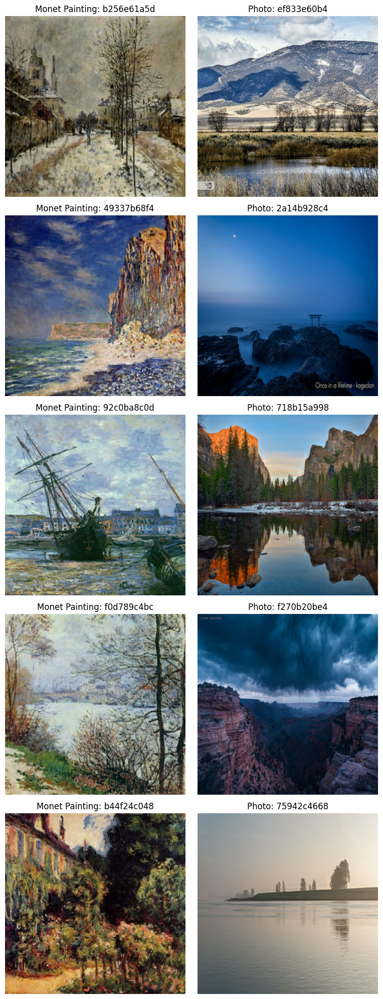

In [9]:
display_monet_and_photos(monet_dataset, photo_dataset)

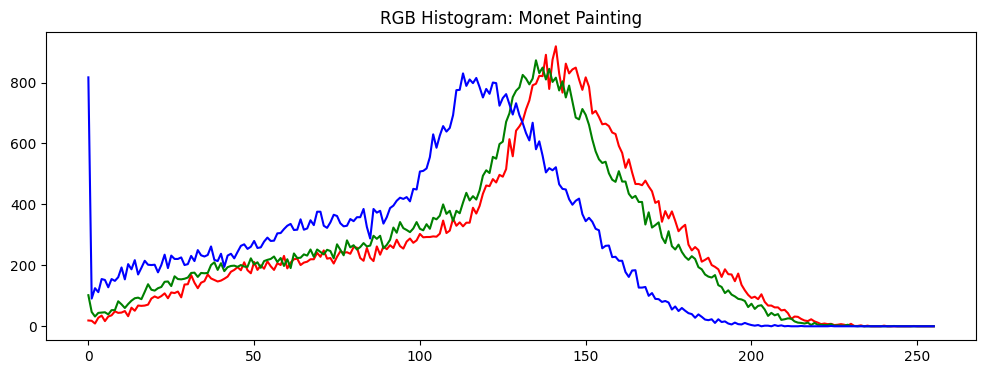

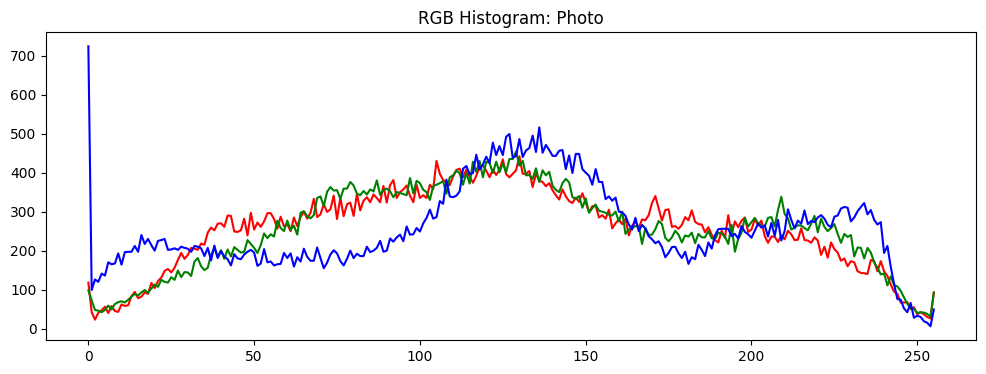

In [24]:
def plot_rgb_histogram(image, title):
    plt.figure(figsize=(12, 4))
    for i, color in enumerate(['red', 'green', 'blue']):
        hist = np.histogram(image[:, :, i], bins=256, range=(0, 255))[0]
        plt.plot(hist, color=color)
    plt.title(f'RGB Histogram: {title}')
    plt.show()

# Get a sample of Monet and photo images and plot histograms
monet_sample_image = next(iter(monet_dataset))[0].numpy()
photo_sample_image = next(iter(photo_dataset))[0].numpy()

plot_rgb_histogram(monet_sample_image, "Monet Painting")
plot_rgb_histogram(photo_sample_image, "Photo")

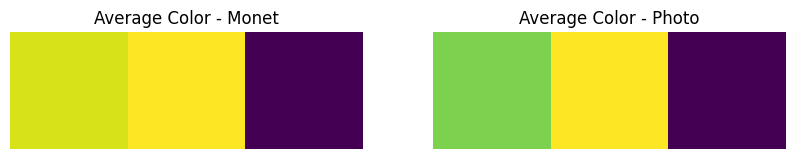

In [26]:
def get_mean_rgb(dataset):
    mean_colors = []
    for img, _, __ in dataset:
        mean_rgb = np.mean(img, axis=(0, 1))  # Average color per channel
        mean_colors.append(mean_rgb)
    return np.array(mean_colors)

# Compute the mean RGB colors for both datasets
monet_mean_colors = get_mean_rgb(monet_dataset)
photo_mean_colors = get_mean_rgb(photo_dataset)

# Plot the mean colors
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow([monet_mean_colors.mean(axis=0) / 255])  
plt.title('Average Color - Monet')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow([photo_mean_colors.mean(axis=0) / 255]) 
plt.title('Average Color - Photo')
plt.axis('off')

plt.show()

The colors among Monet painting and real photos are quiet similar, except Monet's style is slightly warmer.

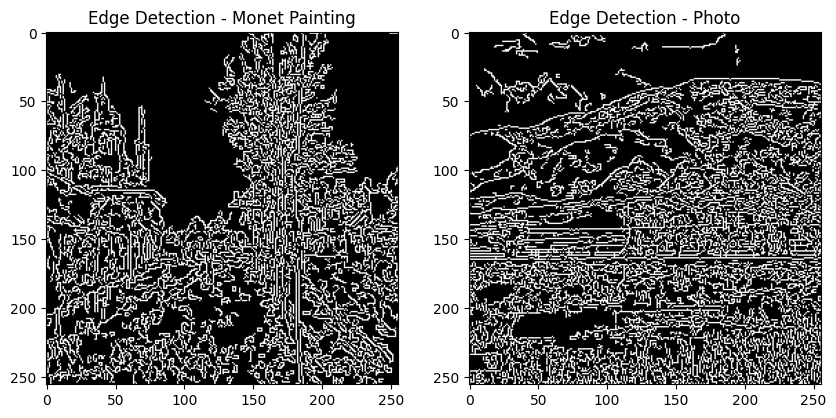

In [28]:
def detect_edges(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray_image, threshold1=100, threshold2=200)
    return edges

# Get edge-detected images
monet_edges = detect_edges(monet_sample_image)
photo_edges = detect_edges(photo_sample_image)

# Plot edge detection results
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(monet_edges, cmap='gray')
plt.title('Edge Detection - Monet Painting')

plt.subplot(1, 2, 2)
plt.imshow(photo_edges, cmap='gray')
plt.title('Edge Detection - Photo')

plt.show()

Interestingly, the real photos seem to have more horizontal edges while Monet prefered to have more vertical edges.

# Model Architecture

## Prepare Data

In [54]:
monet_images = monet_dataset.map(lambda image, image_name, target: (tf.cast(image, tf.float32) / 255.0)).batch(1)
photo_images = photo_dataset.map(lambda image, image_name, target: (tf.cast(image, tf.float32) / 255.0)).batch(1)

## Cycle GAN Model

Our goal is transfering photos to Monet style images, which means our problem is a image to image problem. There is one thing worth to notice, our monet paintings and photos are not paired images. In other words, for each photo, there is no corresponding Monet painting. Luckily, cycle gan are meant to deal with unpaired images.

Like simple gan model, cycle gan also contains generator and discriminator. The difference is cycle gan ultilizes 2 generators and 2 discriminators to transfer images from domin A to domin B.

For this question, we want to transfer images from domin A(real world photos) to domin B(Monet style painting). Cycle gan will build 2 generators, one takes photos as input and output Monet style photos, another one takes output of the first generator as input and output real world style images(undo generator 1). Cycle gan will also build 2 discriminators, one to identify fake Monet style painting that generator 1 generated, another one to identify fake real photos that generator 2 generated.

* Generator G: Photo -> Monet
* Generator F: Monet -> Photo
* Discriminator D_X: Pick up fake Monet styling painting
* Discriminator D_Y: Pick up fake real world photo

All them together form a cycle and play back and forth, and hopeful will give us a good Monet styling generator model.

### About Loss

Like simple gan, cycle gan also compute **adversarial_loss** which evaluate how well the generator is doing in fooling with discriminator. Adversarial loss is calculated by mse of (y_predict and y_true, and y_predict and y_fake). High adversarial loss denotes generator did bad job to fool discriminator and vice versa

Besides adversarial loss, cycle gan also compute **cycle consistency loss**. Cycle consistency loss evaluates how well one generator can undo another generator. For example, our generator G transfer a photo to a monet painting, after we feed this generated monet painting to generator F(photo to monet), generator F should output a monet pointing which is similar to the original monet painting, like a cycle! Cycle consistency loss enforces the translation between two domins are consistent.

We also compute **identity loss** for our cycle gan model. Identity loss evaluates how well a generator take an image from the target domin as input and output a same or very similar images. For example, our generator G is meant to transfer a photo to a monet painting. If we feed G a real monet painting, it should output a same or highly similar painting. Identity loss ensures our model doesn't transfer images unnecessarily and performs stable.

Credits to Jason Brownlee mentioned in section "Implementation Tips for CycleGAN" of this article https://machinelearningmastery.com/what-is-cyclegan/ I quote "The generator model starts with best practices for generators using the deep convolutional GAN, which is implemented using multiple residual blocks (e.g. from the ResNet)." I use residual blocks to build our generators.

In [55]:
def residual_block(x, filters, kernel_size=(3, 3)):
    """Defines a residual block with two convolutional layers."""
    shortcut = x
    x = layers.Conv2D(filters, kernel_size, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    x = layers.Conv2D(filters, kernel_size, padding='same')(x)
    x = layers.BatchNormalization()(x)
    
    return layers.add([shortcut, x])


In [56]:
def build_generator(input_shape):
    inputs = layers.Input(shape=input_shape)
    
    # Initial Conv block
    x = layers.Conv2D(64, (7, 7), padding='same')(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    
    # Downsampling 
    x = layers.Conv2D(128, (3, 3), strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    
    for _ in range(4):
        x = residual_block(x, 128)

    # Upsampling
    x = layers.Conv2DTranspose(64, (3, 3), strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    # Output layer (Tanh for normalized pixel values)
    x = layers.Conv2D(3, (7, 7), padding='same')(x)
    outputs = layers.Activation('tanh')(x)

    return tf.keras.Model(inputs, outputs)

For discriminator side, we use patchGANs which is a common choice for cycleGAN. Unlike traditianal classifier, patchGAN model output a grid of prediction for each corresponding patch. In other words, patchGAN divides the input into small patchs and learn them and predict them seperately. This architecture enables our discriminators efficiently learn local features like texture and pattern of input images.

Here, to make our model slightly simpler, I uses a shallow CNN architecture and output 32 grid of prediction which means for input with shape(256, 256, 3), output with shape(32, 32, 1) reprents the results of each 25 * 25 patch. The best practice is using 70 * 70 patch.

In [57]:
def build_discriminator(input_shape):
    inputs = layers.Input(shape=input_shape)

    x = layers.Conv2D(64, (4, 4), strides=2, padding='same')(inputs)
    x = layers.LeakyReLU(0.2)(x)
    x = layers.Conv2D(128, (4, 4), strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(0.2)(x)
    x = layers.Conv2D(256, (4, 4), strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(0.2)(x)
    x = layers.Conv2D(512, (4, 4), strides=1, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(0.2)(x)

    x = layers.Conv2D(1, (4, 4), strides=1, padding='same')(x)
    return tf.keras.Model(inputs, x)

In [58]:
image_shape = (256, 256, 3) 

In [59]:
G = build_generator(image_shape)  # Photo → Monet
F = build_generator(image_shape)  # Monet → Photo

D_X = build_discriminator(image_shape)  # Discriminator for Monet images
D_Y = build_discriminator(image_shape) # Discriminator for Photo images

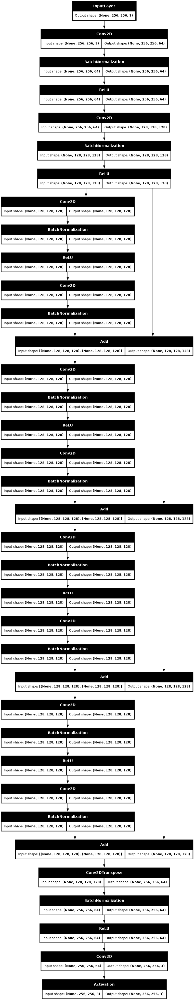

In [35]:
tf.keras.utils.plot_model(G, show_shapes=True, dpi=64)

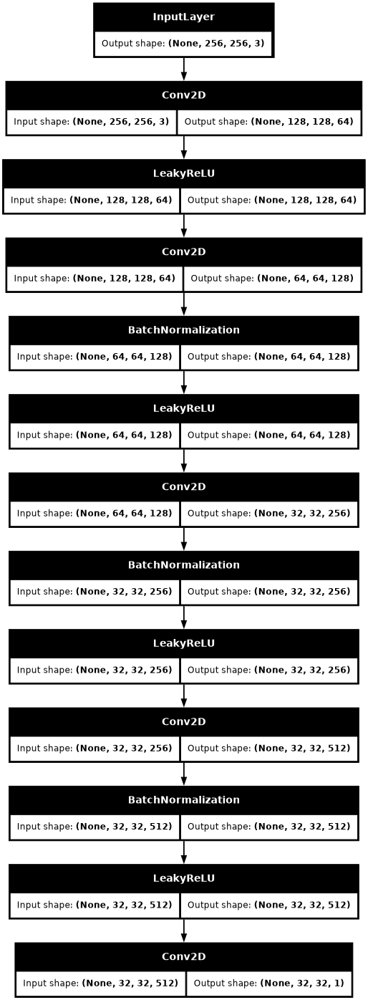

In [36]:
tf.keras.utils.plot_model(D_X, show_shapes=True, dpi=64)

In [60]:
mse = tf.keras.losses.MeanSquaredError()

def adversarial_loss(y_real, y_fake):
    return mse(tf.ones_like(y_real), y_fake)

def cycle_consistency_loss(real_image, cycled_image, lambda_cycle):
    loss = tf.reduce_mean(tf.abs(real_image - cycled_image))
    return lambda_cycle * loss

def identity_loss(real_image, same_image, lambda_identity):
    loss = tf.reduce_mean(tf.abs(real_image - same_image))
    return lambda_identity * loss

In [61]:
g_optimizer = tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)
f_optimizer = tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)
d_x_optimizer = tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)
d_y_optimizer = tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)

In [67]:
@tf.function
def train_step(real_photo, real_monet, models, optimizers, 
               lambda_cycle=10, lambda_identity=5):
    G, F, D_X, D_Y = models
    g_optimizer, f_optimizer, d_x_optimizer, d_y_optimizer = optimizers
    # GradientTape for updating both generators
    with tf.GradientTape(persistent=True) as tape:
        
        # Generate fake Monet image (Photo → Monet) and reconstruct back (Monet → Photo)
        fake_monet = G(real_photo, training=True)
        cycled_photo = F(fake_monet, training=True)
        
        # Generate fake Photo image (Monet → Photo) and reconstruct back (Photo → Monet)
        fake_photo = F(real_monet, training=True)
        cycled_monet = G(fake_photo, training=True)       

        # Identity Mapping
        same_monet = G(real_monet, training=True)
        same_photo = F(real_photo, training=True)
        
        # Discriminator prediction for real and fake images
        disc_real_monet = D_X(real_monet, training=True)
        disc_fake_monet = D_X(fake_monet, training=True)
        
        disc_real_photo = D_Y(real_photo, training=True)
        disc_fake_photo = D_Y(fake_photo, training=True)
        
        # ===== Losses =====
        
        # Generator adversarial loss (G: Photo → Monet, F: Monet → Photo)
        gen_g_loss = adversarial_loss(disc_real_monet, disc_fake_monet)
        gen_f_loss = adversarial_loss(disc_real_photo, disc_fake_photo)
        
        # Cycle consistency loss
        cycle_loss_g = cycle_consistency_loss(real_photo, cycled_photo, lambda_cycle)
        cycle_loss_f = cycle_consistency_loss(real_monet, cycled_monet, lambda_cycle)
        
        # Identity loss 
        id_loss_g = identity_loss(real_monet, same_monet, lambda_identity)
        id_loss_f = identity_loss(real_photo, same_photo, lambda_identity)
        
        # Total generator loss
        total_loss_g = gen_g_loss + cycle_loss_g + id_loss_g
        total_loss_f = gen_f_loss + cycle_loss_f + id_loss_f

        # Discriminator loss for Monet (D_X) and Photos (D_Y)
        disc_x_loss = adversarial_loss(disc_real_monet, disc_fake_monet)
        disc_y_loss = adversarial_loss(disc_real_photo, disc_fake_photo)
    
    # ====== Compute Gradients ======
    # Gradients for generators
    grad_g = tape.gradient(total_loss_g, G.trainable_variables)
    grad_f = tape.gradient(total_loss_f, F.trainable_variables)
    
    # Gradients for discriminators
    grad_d_x = tape.gradient(disc_x_loss, D_X.trainable_variables)
    grad_d_y = tape.gradient(disc_y_loss, D_Y.trainable_variables)
    
    # ====== Apply Gradients ======
    g_optimizer.apply_gradients(zip(grad_g, G.trainable_variables))
    f_optimizer.apply_gradients(zip(grad_f, F.trainable_variables))
    
    d_x_optimizer.apply_gradients(zip(grad_d_x, D_X.trainable_variables))
    d_y_optimizer.apply_gradients(zip(grad_d_y, D_Y.trainable_variables))
    
    return {
        "gen_g_loss": total_loss_g,
        "gen_f_loss": total_loss_f,
        "disc_x_loss": disc_x_loss,
        "disc_y_loss": disc_y_loss
    }


In [68]:
def generate_and_save_images(G, photo_sample, epoch, save_dir='tmp/generated_images/'):
    # Generate Monet-style image from a photo using G
    generated_monet = G(photo_sample, training=False)  
    plt.figure(figsize=(10, 10))
    
    plt.subplot(1, 2, 1)
    plt.title("Original Photo")
    plt.imshow(photo_sample[0] * 0.5 + 0.5)  # Rescale [-1, 1] to [0, 1]
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.title("Generated Monet Style (G)")
    plt.imshow(generated_monet[0] * 0.5 + 0.5)  # Rescale [-1, 1] to [0, 1]
    plt.axis('off')
    
#     plt.subplot(2, 2, 3)
#     plt.title("Original Monet Painting")
#     plt.imshow(monet_sample[0] * 0.5 + 0.5)  # Rescale [-1, 1] to [0, 1]
#     plt.axis('off')
    
#     plt.subplot(2, 2, 4)
#     plt.title("Generated Photo Style (F)")
#     plt.imshow(generated_photo[0] * 0.5 + 0.5)  # Rescale [-1, 1] to [0, 1]
#     plt.axis('off')
    
    # Save the plot to a file
    # plt.savefig(f"{save_dir}epoch_{epoch}.png")
    plt.show()


In [98]:
import time
def train_cycle_gan(models, optimizers, monet_images, photo_images, epochs=100, show_example=True):
    G, F, D_X, D_Y = models
    for epoch in range(epochs):
        print(f"Epoch {epoch+1}/{epochs}")
        time0 = time.time()
        
        for real_monet, real_photo in tf.data.Dataset.zip((monet_images, photo_images)): 
            train_step(real_photo, real_monet, models, optimizers)            
            
        time1 = time.time()
        print(f"Epoch {epoch + 1} takes {time1 - time0} s")        
        if show_example:
            photo_sample = next(iter(photo_images.take(1)))        
            photo_sample = (photo_sample - 0.5) * 2  # Normalize to [-1, 1]
            generate_and_save_images(G, photo_sample, epoch)


Epoch 1/20
Epoch 1 takes 96.79103827476501 s


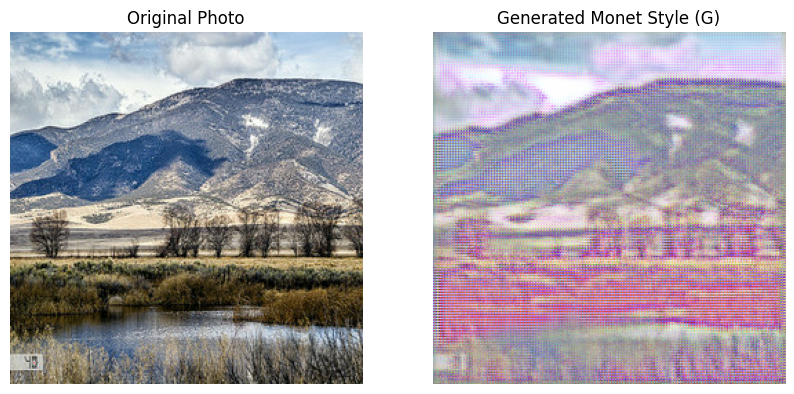

Epoch 2/20
Epoch 2 takes 70.22904086112976 s


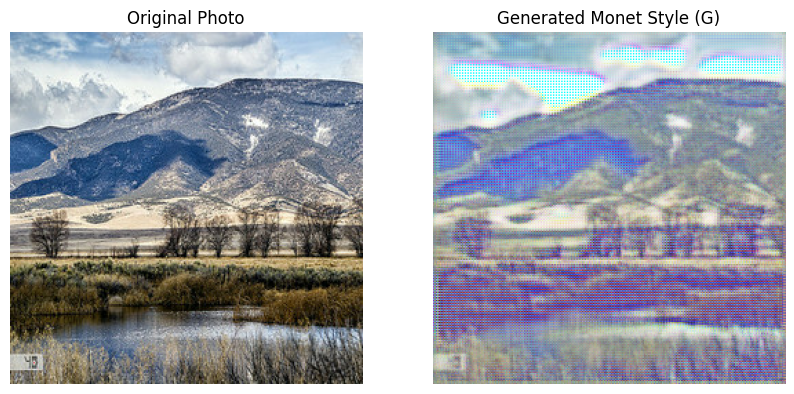

Epoch 3/20
Epoch 3 takes 70.2323157787323 s


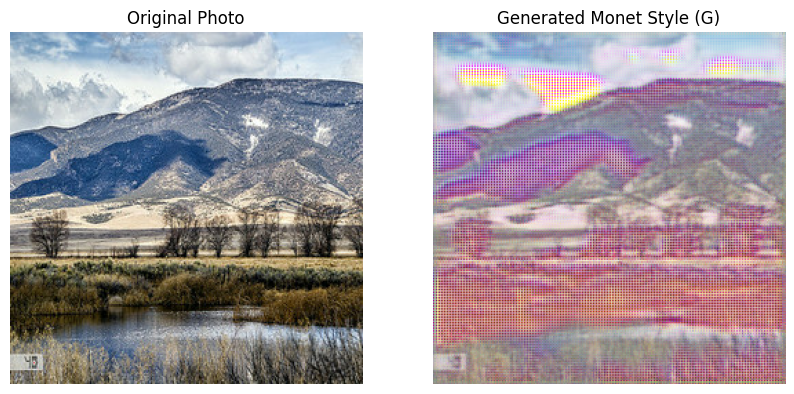

Epoch 4/20
Epoch 4 takes 70.17744946479797 s


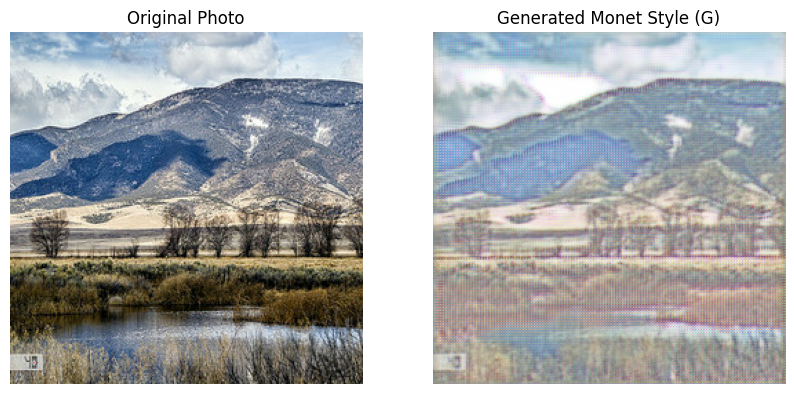

Epoch 5/20
Epoch 5 takes 70.1834306716919 s


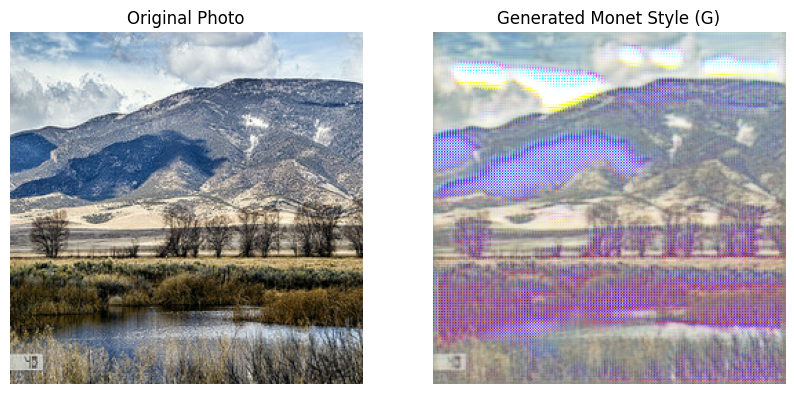

Epoch 6/20
Epoch 6 takes 70.2178738117218 s


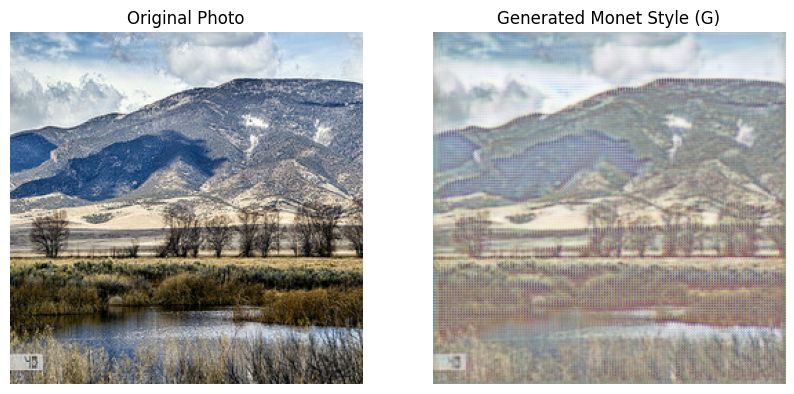

Epoch 7/20
Epoch 7 takes 70.18614602088928 s


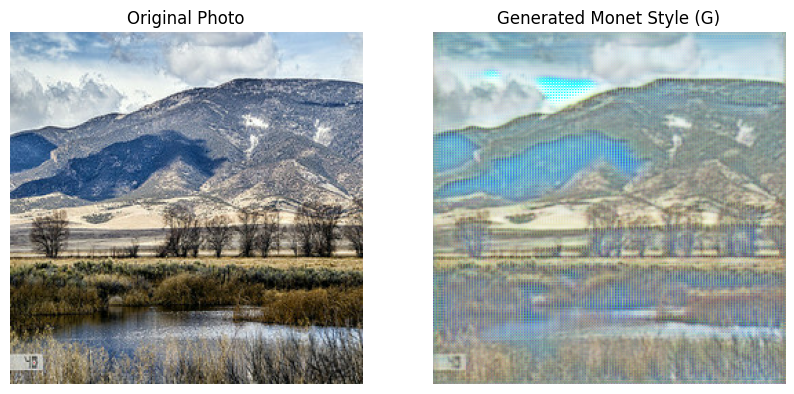

Epoch 8/20
Epoch 8 takes 70.20126247406006 s


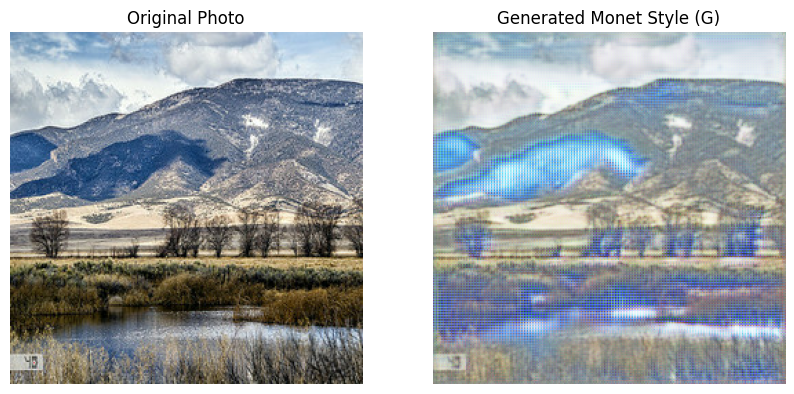

Epoch 9/20
Epoch 9 takes 70.21075654029846 s


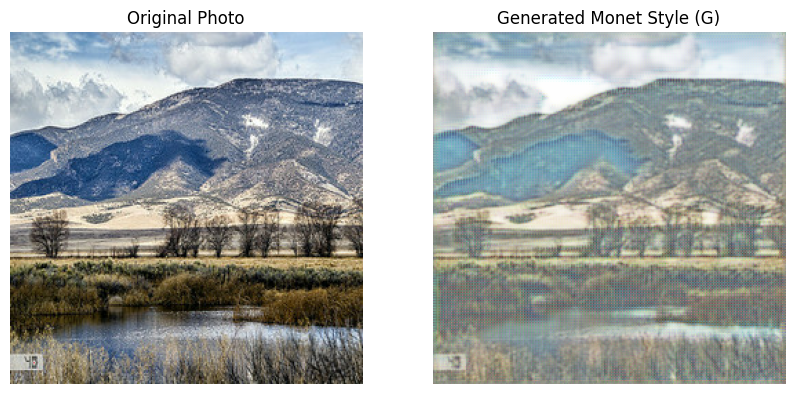

Epoch 10/20
Epoch 10 takes 70.20976901054382 s


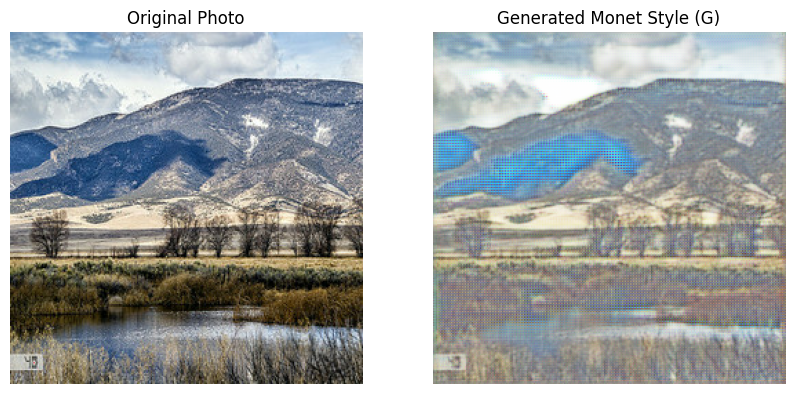

Epoch 11/20
Epoch 11 takes 70.17643618583679 s


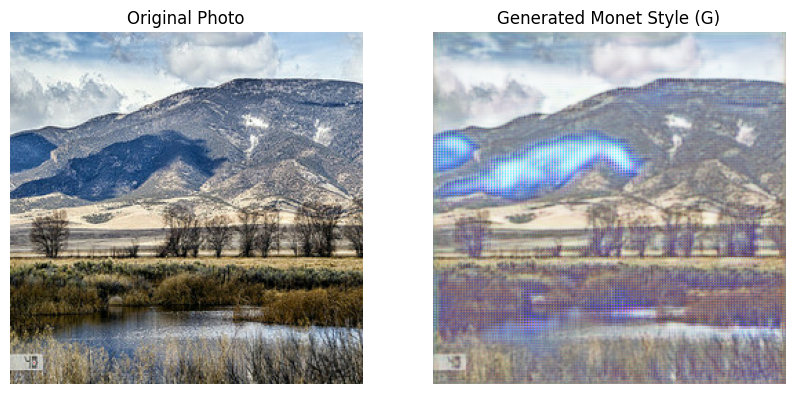

Epoch 12/20
Epoch 12 takes 70.2052812576294 s


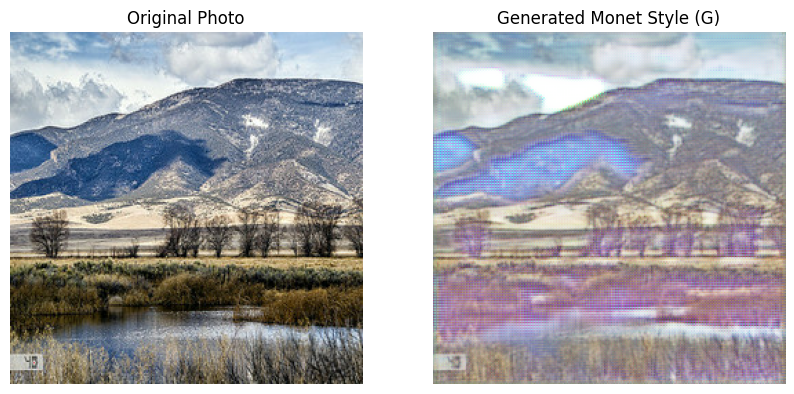

Epoch 13/20
Epoch 13 takes 70.19275069236755 s


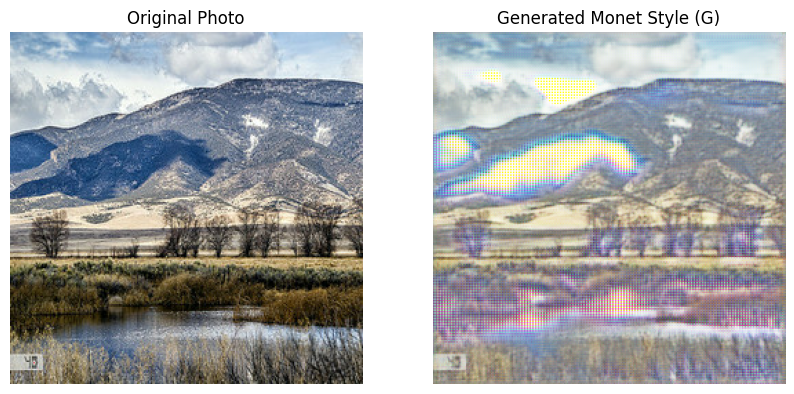

Epoch 14/20
Epoch 14 takes 70.19343972206116 s


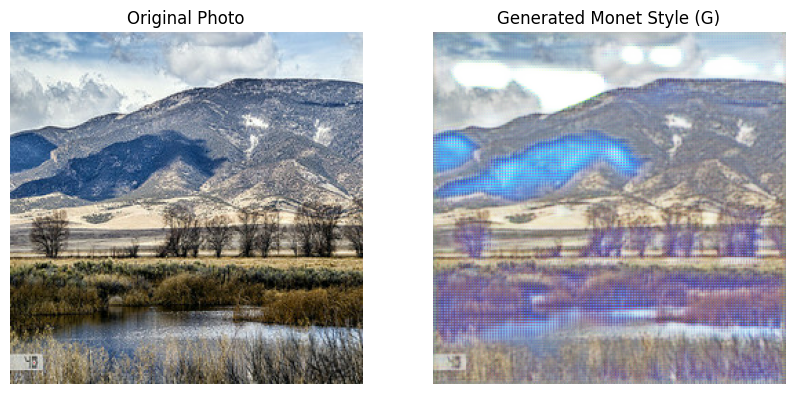

Epoch 15/20
Epoch 15 takes 70.15310740470886 s


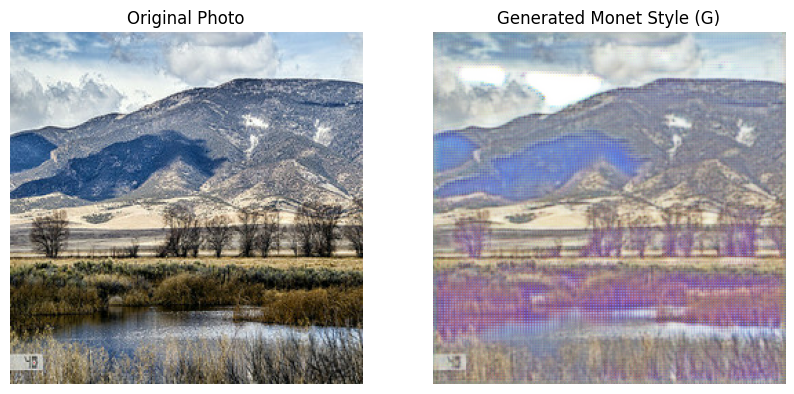

Epoch 16/20
Epoch 16 takes 70.20000958442688 s


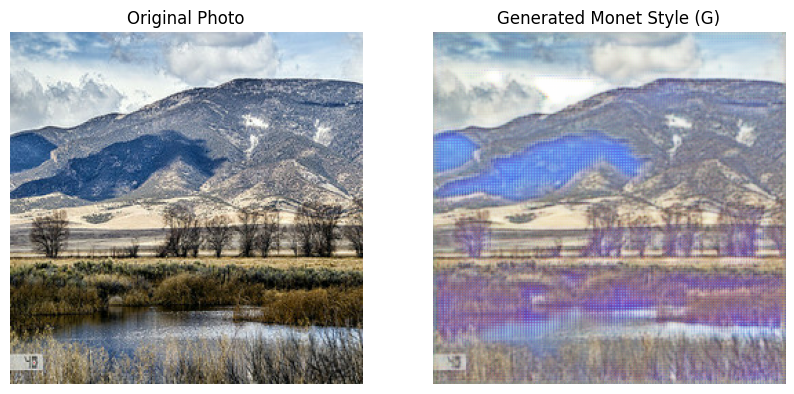

Epoch 17/20
Epoch 17 takes 70.17326831817627 s


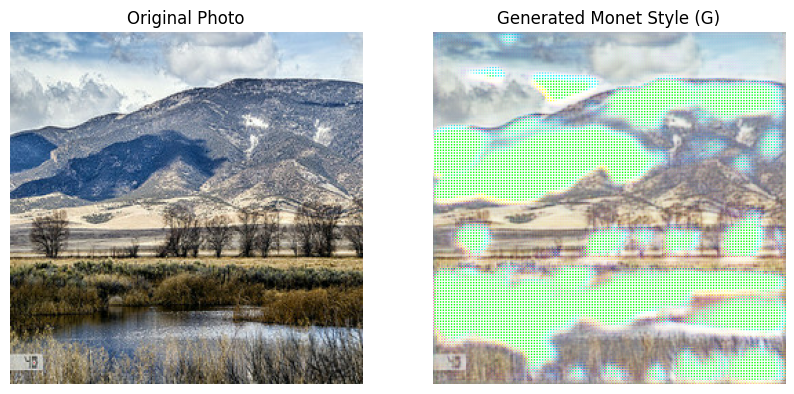

Epoch 18/20
Epoch 18 takes 70.1501317024231 s


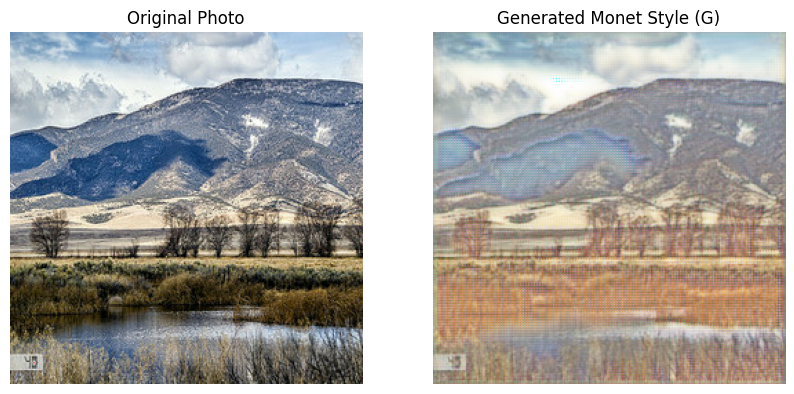

Epoch 19/20
Epoch 19 takes 70.16152024269104 s


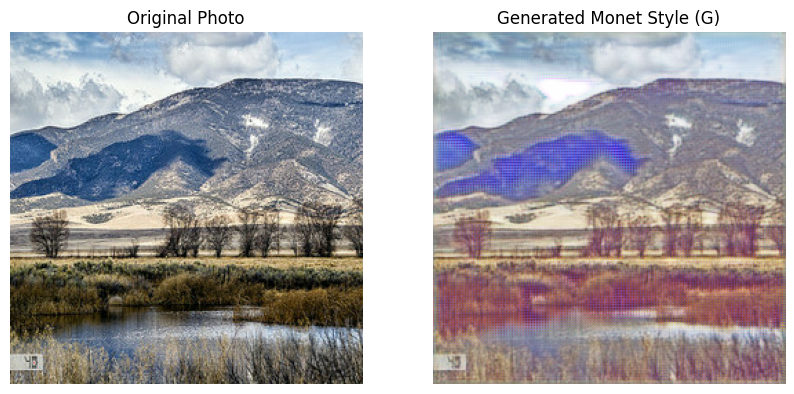

Epoch 20/20
Epoch 20 takes 70.1841607093811 s


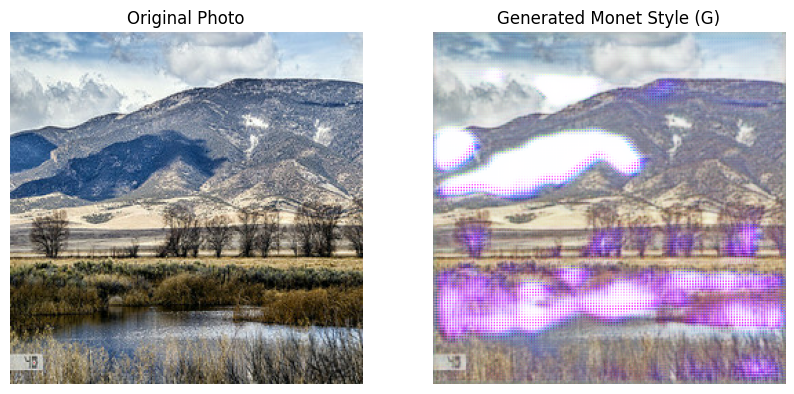

CPU times: user 18min 59s, sys: 9min 35s, total: 28min 34s
Wall time: 23min 58s


In [64]:
%%time
optimizers = (g_optimizer, f_optimizer, d_x_optimizer, d_y_optimizer)
train_cycle_gan((G, F, D_X, D_Y),optimizers, monet_images, photo_images, epochs=20)

There are some pictures look good!

## Hyperparameter Tuning

In [96]:
def tune_train(lr=2e-4, beta=0.5, epoch=20, show_example=True):    

    G_tune = build_generator(image_shape)  # Photo → Monet
    F_tune = build_generator(image_shape)  # Monet → Photo
    D_X_tune = build_discriminator(image_shape)  # Discriminator for Monet images
    D_Y_tune = build_discriminator(image_shape) # Discriminator for Photo images
    models_tune = (G_tune, F_tune, D_X_tune, D_Y_tune)
    
    g_optimizer_tune = tf.keras.optimizers.Adam(learning_rate=lr, beta_1=beta)
    f_optimizer_tune = tf.keras.optimizers.Adam(learning_rate=lr, beta_1=beta)
    d_x_optimizer_tune = tf.keras.optimizers.Adam(learning_rate=lr, beta_1=beta)
    d_y_optimizer_tune = tf.keras.optimizers.Adam(learning_rate=lr, beta_1=beta)    
    optimizers_tune = (g_optimizer_tune, f_optimizer_tune, d_x_optimizer_tune, d_y_optimizer_tune)
    
    train_cycle_gan(models_tune,optimizers_tune, monet_images, photo_images, epochs=epoch, show_example=show_example)
    return G_tune

Note: as the train_step is a tf function, and the tf varibles that the tf function used can only be created once. To make tuning hyperparameter simpler, we need to run train_step block before run tune_train

In [86]:
@tf.function
def train_step(real_photo, real_monet, models, optimizers, 
           lambda_cycle=10, lambda_identity=5):
    G, F, D_X, D_Y = models
    g_optimizer, f_optimizer, d_x_optimizer, d_y_optimizer = optimizers
    # GradientTape for updating both generators
    with tf.GradientTape(persistent=True) as tape:
        # Generate fake Monet image (Photo → Monet) and reconstruct back (Monet → Photo)
        fake_monet = G(real_photo, training=True)
        cycled_photo = F(fake_monet, training=True)

        # Generate fake Photo image (Monet → Photo) and reconstruct back (Photo → Monet)
        fake_photo = F(real_monet, training=True)
        cycled_monet = G(fake_photo, training=True)       

        # Identity Mapping
        same_monet = G(real_monet, training=True)
        same_photo = F(real_photo, training=True)

        # Discriminator prediction for real and fake images
        disc_real_monet = D_X(real_monet, training=True)
        disc_fake_monet = D_X(fake_monet, training=True)

        disc_real_photo = D_Y(real_photo, training=True)
        disc_fake_photo = D_Y(fake_photo, training=True)

        # ===== Losses =====

        # Generator adversarial loss (G: Photo → Monet, F: Monet → Photo)
        gen_g_loss = adversarial_loss(disc_real_monet, disc_fake_monet)
        gen_f_loss = adversarial_loss(disc_real_photo, disc_fake_photo)

        # Cycle consistency loss
        cycle_loss_g = cycle_consistency_loss(real_photo, cycled_photo, lambda_cycle)
        cycle_loss_f = cycle_consistency_loss(real_monet, cycled_monet, lambda_cycle)

        # Identity loss 
        id_loss_g = identity_loss(real_monet, same_monet, lambda_identity)
        id_loss_f = identity_loss(real_photo, same_photo, lambda_identity)

        # Total generator loss
        total_loss_g = gen_g_loss + cycle_loss_g + id_loss_g
        total_loss_f = gen_f_loss + cycle_loss_f + id_loss_f

        # Discriminator loss for Monet (D_X) and Photos (D_Y)
        disc_x_loss = adversarial_loss(disc_real_monet, disc_fake_monet)
        disc_y_loss = adversarial_loss(disc_real_photo, disc_fake_photo)

    # ====== Compute Gradients ======
    # Gradients for generators
    grad_g = tape.gradient(total_loss_g, G.trainable_variables)
    grad_f = tape.gradient(total_loss_f, F.trainable_variables)

    # Gradients for discriminators
    grad_d_x = tape.gradient(disc_x_loss, D_X.trainable_variables)
    grad_d_y = tape.gradient(disc_y_loss, D_Y.trainable_variables)

    # ====== Apply Gradients ======
    g_optimizer.apply_gradients(zip(grad_g, G.trainable_variables))
    f_optimizer.apply_gradients(zip(grad_f, F.trainable_variables))

    d_x_optimizer.apply_gradients(zip(grad_d_x, D_X.trainable_variables))
    d_y_optimizer.apply_gradients(zip(grad_d_y, D_Y.trainable_variables))

    return {
        "gen_g_loss": total_loss_g,
        "gen_f_loss": total_loss_f,
        "disc_x_loss": disc_x_loss,
        "disc_y_loss": disc_y_loss
    }

Epoch 1/15
Epoch 1 takes 95.67140889167786 s


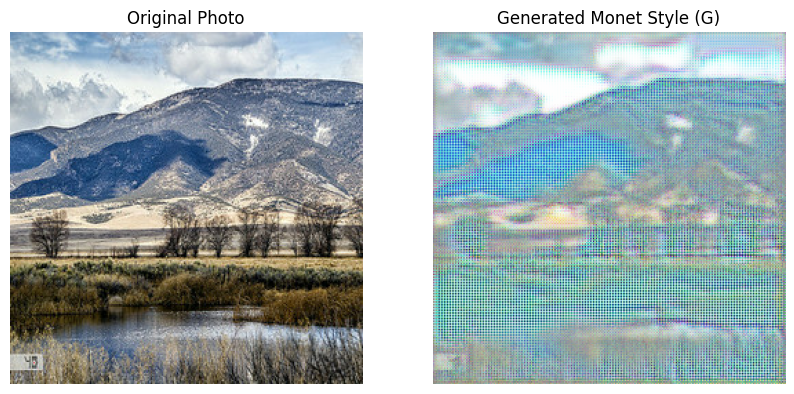

Epoch 2/15
Epoch 2 takes 70.19762754440308 s


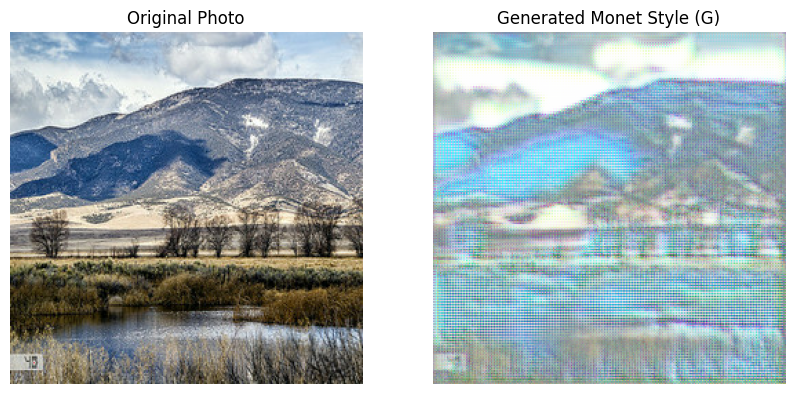

Epoch 3/15
Epoch 3 takes 70.17563056945801 s


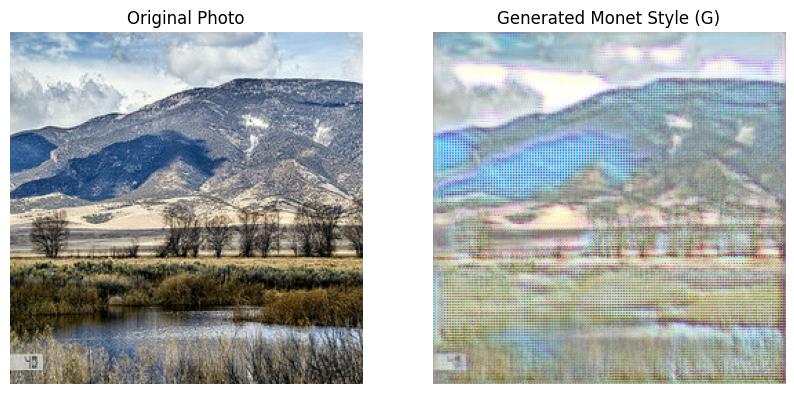

Epoch 4/15
Epoch 4 takes 70.16382455825806 s


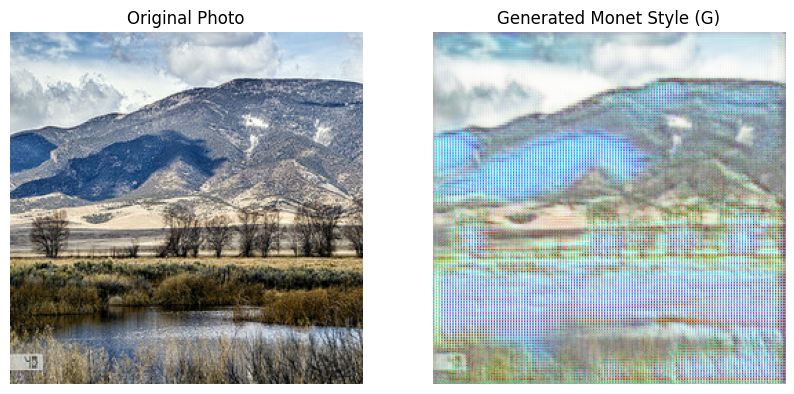

Epoch 5/15
Epoch 5 takes 70.15829849243164 s


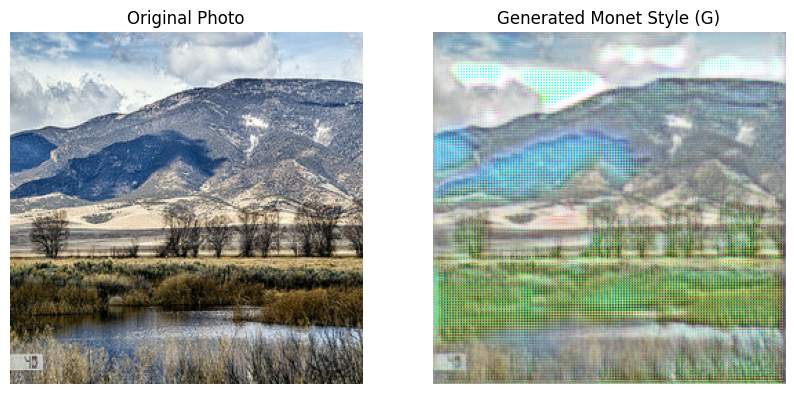

Epoch 6/15
Epoch 6 takes 70.13327741622925 s


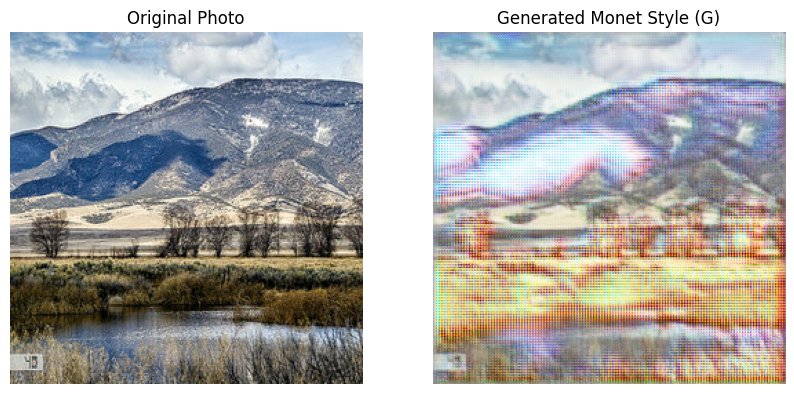

Epoch 7/15
Epoch 7 takes 70.13591313362122 s


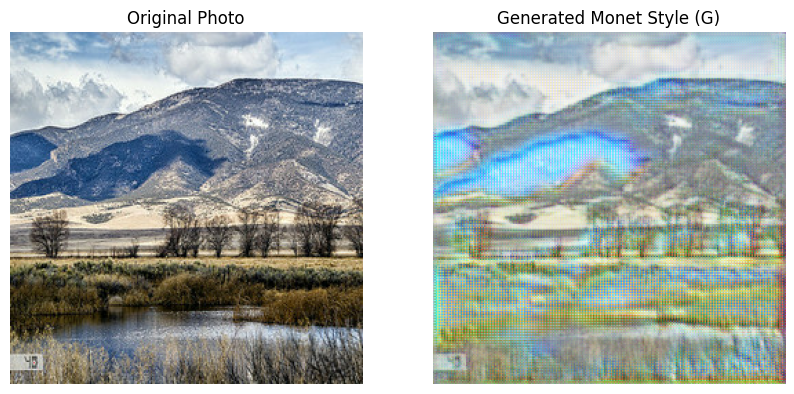

Epoch 8/15
Epoch 8 takes 70.18119096755981 s


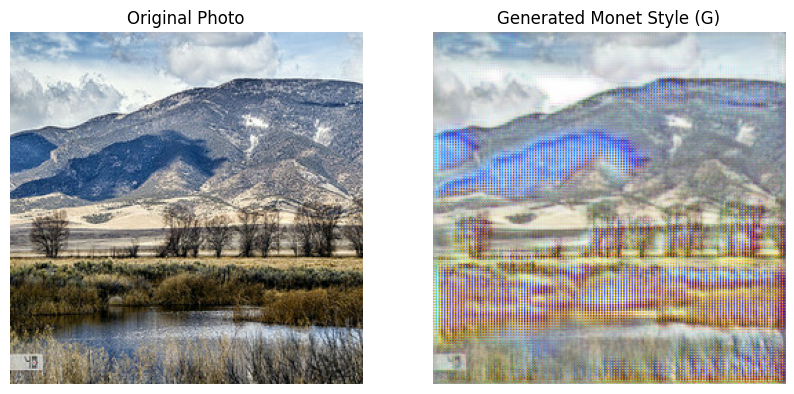

Epoch 9/15
Epoch 9 takes 70.16091179847717 s


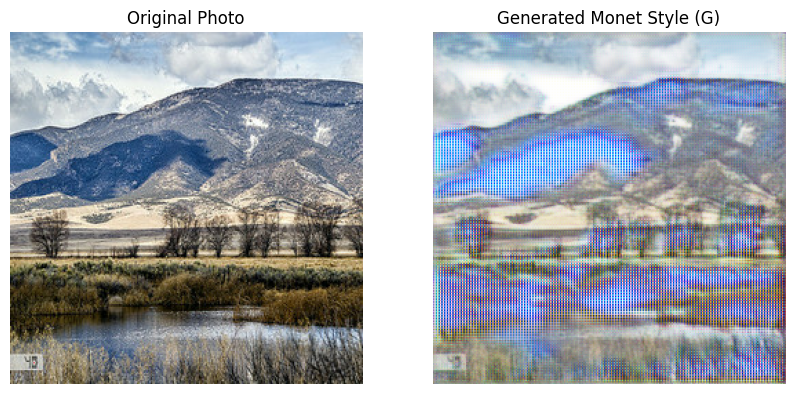

Epoch 10/15
Epoch 10 takes 70.1248767375946 s


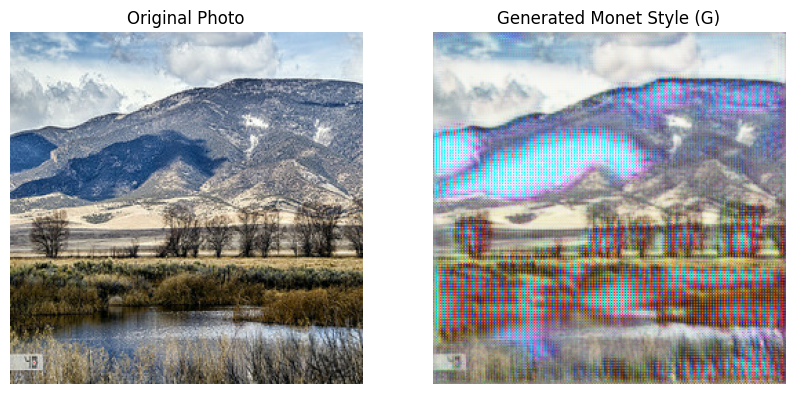

Epoch 11/15
Epoch 11 takes 70.15692830085754 s


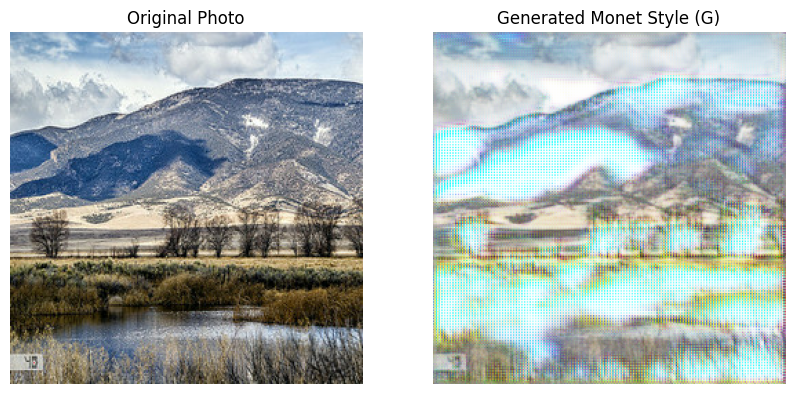

Epoch 12/15
Epoch 12 takes 70.13113021850586 s


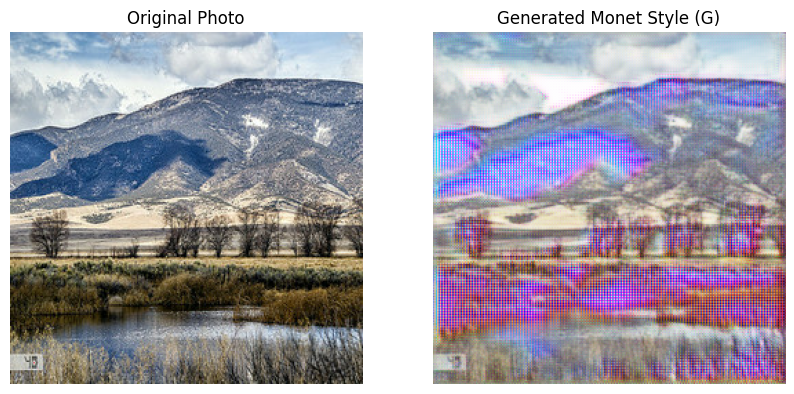

Epoch 13/15
Epoch 13 takes 70.10856437683105 s


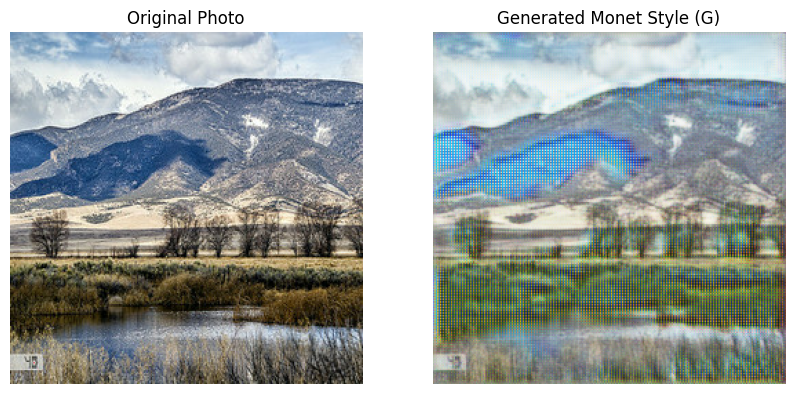

Epoch 14/15
Epoch 14 takes 70.12714433670044 s


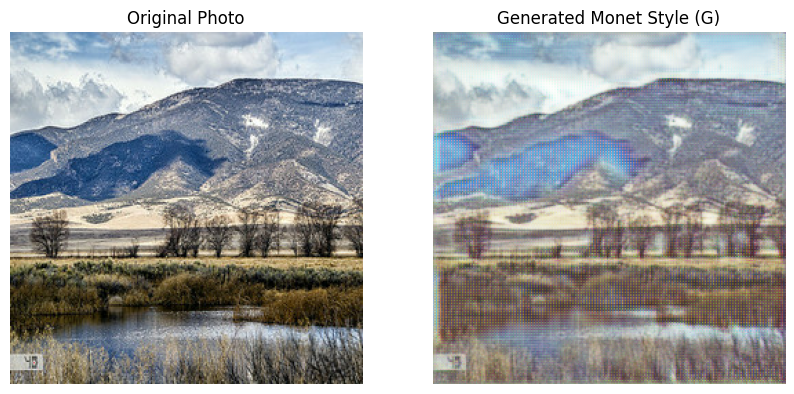

Epoch 15/15
Epoch 15 takes 70.13916540145874 s


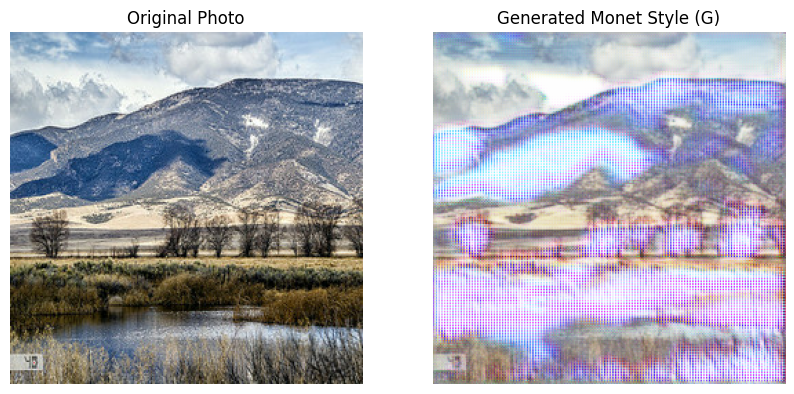

In [87]:
G_1 = tune_train(lr=1e-4, epoch=15)

It looks like 1e-4 is too slow! Let's try 1e-3

In [88]:
@tf.function
def train_step(real_photo, real_monet, models, optimizers, 
               lambda_cycle=10, lambda_identity=5):
    G, F, D_X, D_Y = models
    g_optimizer, f_optimizer, d_x_optimizer, d_y_optimizer = optimizers
    # GradientTape for updating both generators
    with tf.GradientTape(persistent=True) as tape:
        # Generate fake Monet image (Photo → Monet) and reconstruct back (Monet → Photo)
        fake_monet = G(real_photo, training=True)
        cycled_photo = F(fake_monet, training=True)
        
        # Generate fake Photo image (Monet → Photo) and reconstruct back (Photo → Monet)
        fake_photo = F(real_monet, training=True)
        cycled_monet = G(fake_photo, training=True)       

        # Identity Mapping
        same_monet = G(real_monet, training=True)
        same_photo = F(real_photo, training=True)

        # Discriminator prediction for real and fake images
        disc_real_monet = D_X(real_monet, training=True)
        disc_fake_monet = D_X(fake_monet, training=True)

        disc_real_photo = D_Y(real_photo, training=True)
        disc_fake_photo = D_Y(fake_photo, training=True)

        # ===== Losses =====

        # Generator adversarial loss (G: Photo → Monet, F: Monet → Photo)
        gen_g_loss = adversarial_loss(disc_real_monet, disc_fake_monet)
        gen_f_loss = adversarial_loss(disc_real_photo, disc_fake_photo)

        # Cycle consistency loss
        cycle_loss_g = cycle_consistency_loss(real_photo, cycled_photo, lambda_cycle)
        cycle_loss_f = cycle_consistency_loss(real_monet, cycled_monet, lambda_cycle)

        # Identity loss 
        id_loss_g = identity_loss(real_monet, same_monet, lambda_identity)
        id_loss_f = identity_loss(real_photo, same_photo, lambda_identity)

        # Total generator loss
        total_loss_g = gen_g_loss + cycle_loss_g + id_loss_g
        total_loss_f = gen_f_loss + cycle_loss_f + id_loss_f

        # Discriminator loss for Monet (D_X) and Photos (D_Y)
        disc_x_loss = adversarial_loss(disc_real_monet, disc_fake_monet)
        disc_y_loss = adversarial_loss(disc_real_photo, disc_fake_photo)

    # ====== Compute Gradients ======
    # Gradients for generators
    grad_g = tape.gradient(total_loss_g, G.trainable_variables)
    grad_f = tape.gradient(total_loss_f, F.trainable_variables)

    # Gradients for discriminators
    grad_d_x = tape.gradient(disc_x_loss, D_X.trainable_variables)
    grad_d_y = tape.gradient(disc_y_loss, D_Y.trainable_variables)

    # ====== Apply Gradients ======
    g_optimizer.apply_gradients(zip(grad_g, G.trainable_variables))
    f_optimizer.apply_gradients(zip(grad_f, F.trainable_variables))

    d_x_optimizer.apply_gradients(zip(grad_d_x, D_X.trainable_variables))
    d_y_optimizer.apply_gradients(zip(grad_d_y, D_Y.trainable_variables))

    return {
        "gen_g_loss": total_loss_g,
        "gen_f_loss": total_loss_f,
        "disc_x_loss": disc_x_loss,
        "disc_y_loss": disc_y_loss
    }

Epoch 1/15
Epoch 1 takes 97.52447152137756 s


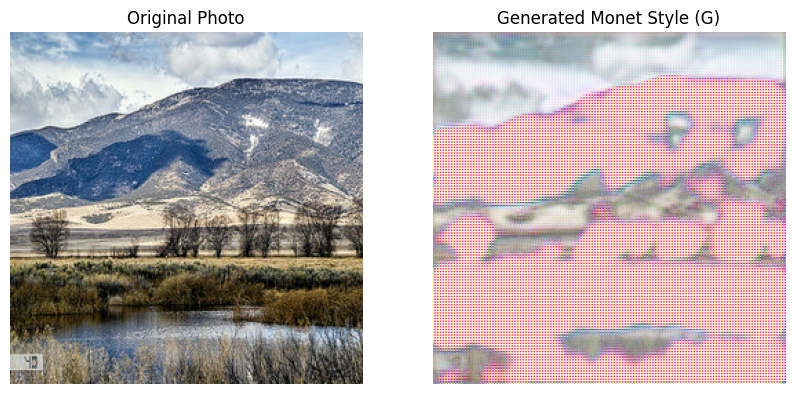

Epoch 2/15
Epoch 2 takes 70.12664461135864 s


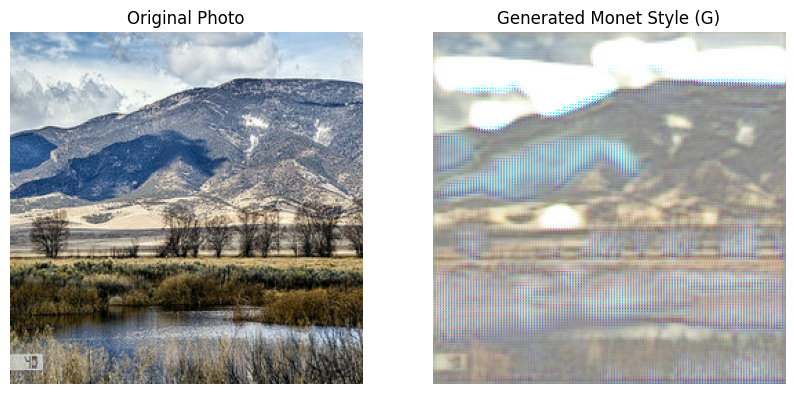

Epoch 3/15
Epoch 3 takes 70.14052486419678 s


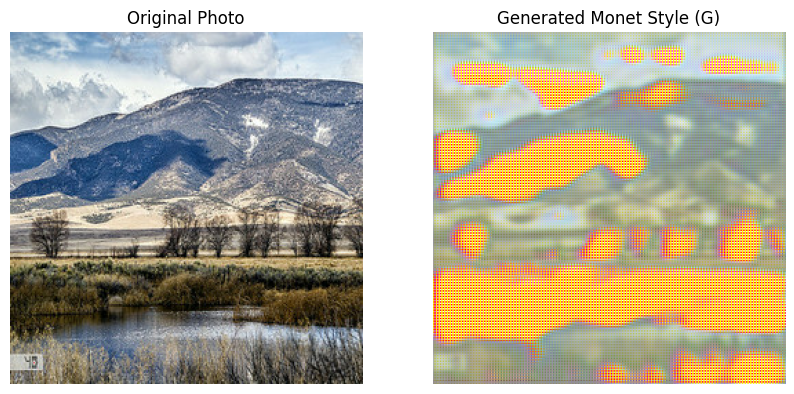

Epoch 4/15
Epoch 4 takes 70.16850852966309 s


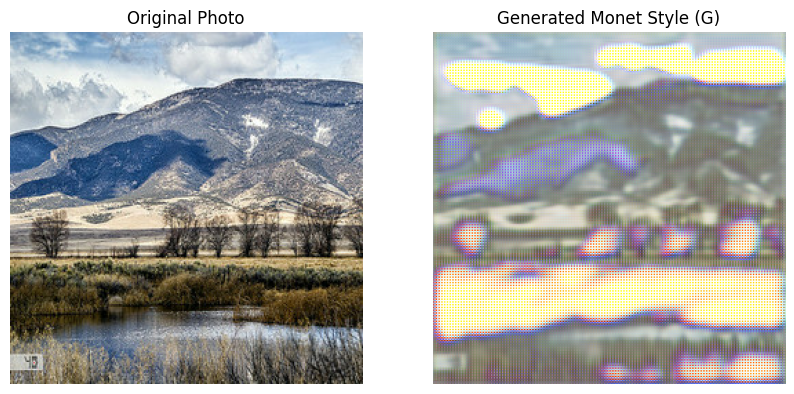

Epoch 5/15
Epoch 5 takes 70.14892339706421 s


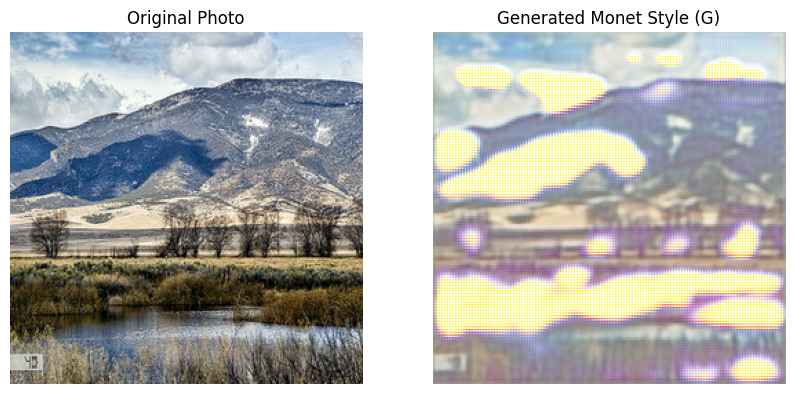

Epoch 6/15
Epoch 6 takes 70.1293351650238 s


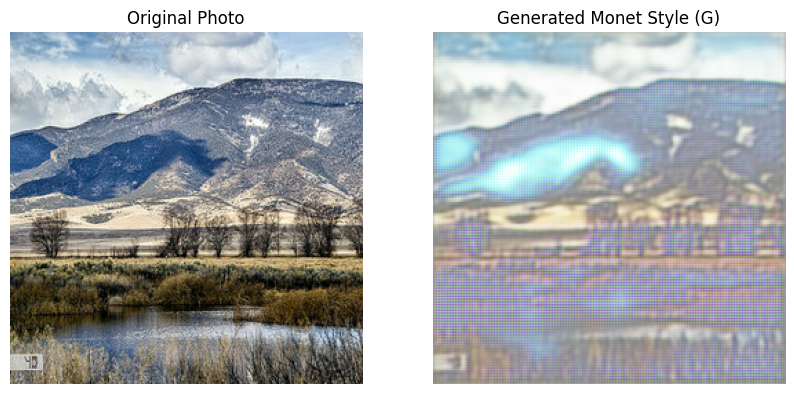

Epoch 7/15
Epoch 7 takes 70.16410708427429 s


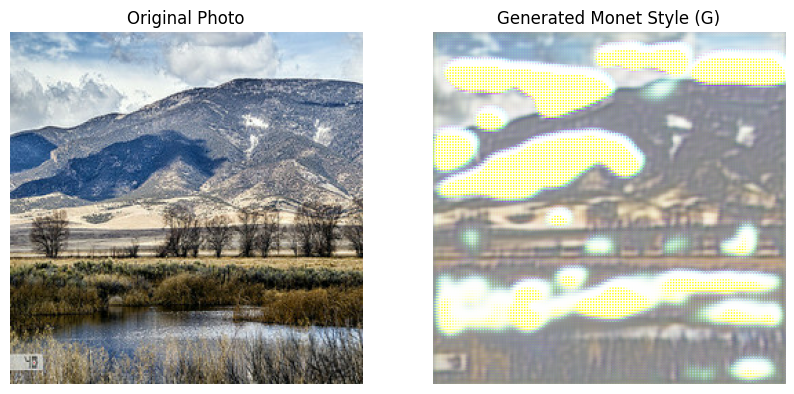

Epoch 8/15
Epoch 8 takes 70.1206738948822 s


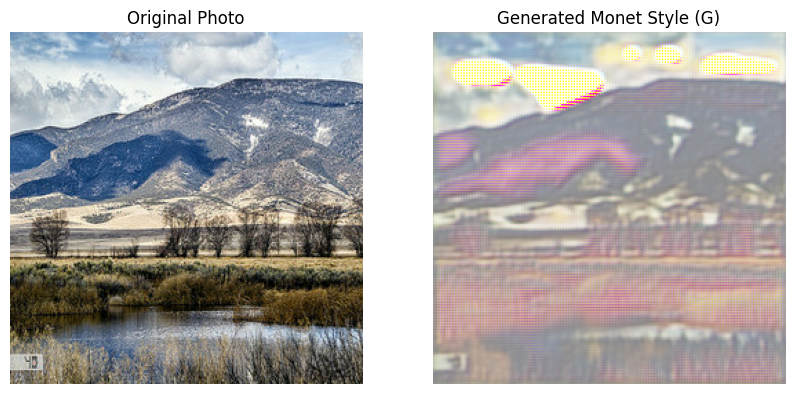

Epoch 9/15
Epoch 9 takes 70.13225221633911 s


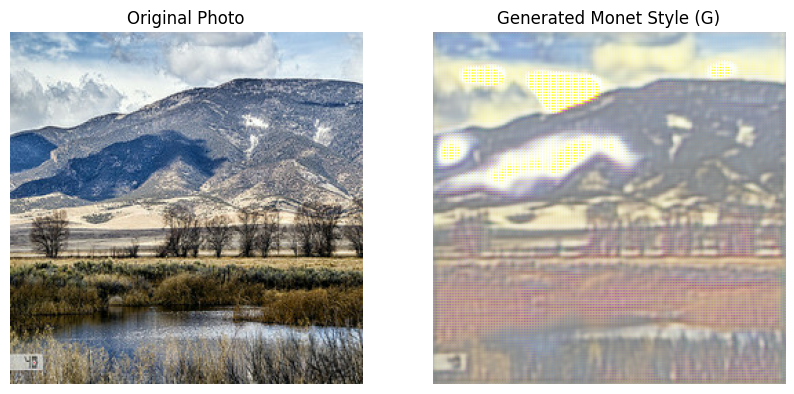

Epoch 10/15
Epoch 10 takes 70.10581922531128 s


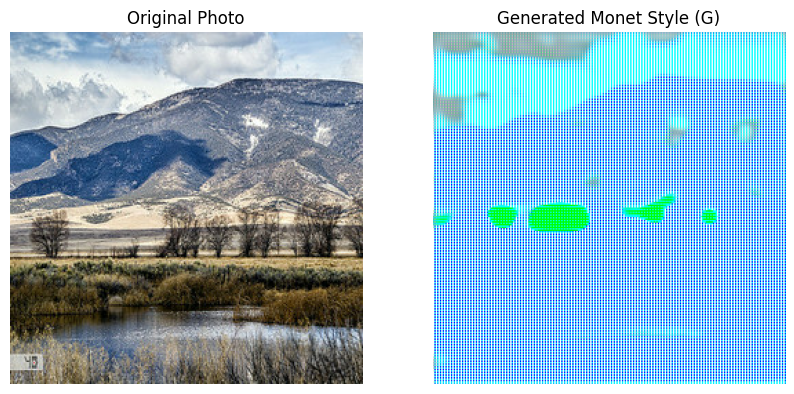

Epoch 11/15
Epoch 11 takes 70.16544532775879 s


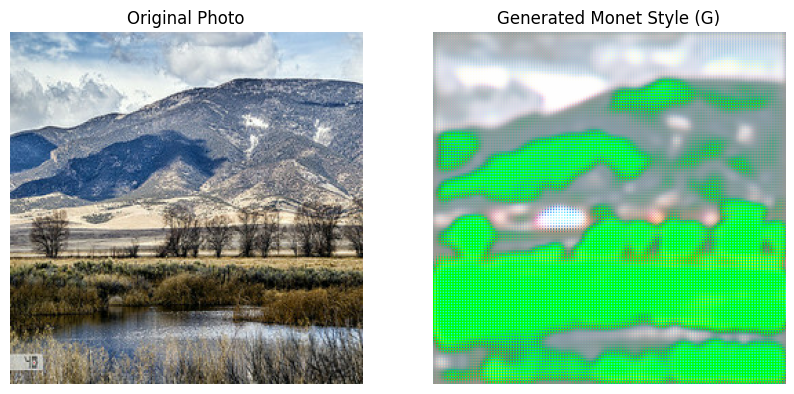

Epoch 12/15


KeyboardInterrupt: 

In [89]:
G_2 = tune_train(lr=1e-3, epoch=15)

It looks like 1e3 learning rate is too aggressive. Let's go back to 2e-4 now and increase epochs.

In [101]:
@tf.function
def train_step(real_photo, real_monet, models, optimizers, 
               lambda_cycle=10, lambda_identity=5):
    G, F, D_X, D_Y = models
    g_optimizer, f_optimizer, d_x_optimizer, d_y_optimizer = optimizers
    # GradientTape for updating both generators
    with tf.GradientTape(persistent=True) as tape:
        # Generate fake Monet image (Photo → Monet) and reconstruct back (Monet → Photo)
        fake_monet = G(real_photo, training=True)
        cycled_photo = F(fake_monet, training=True)
        
        # Generate fake Photo image (Monet → Photo) and reconstruct back (Photo → Monet)
        fake_photo = F(real_monet, training=True)
        cycled_monet = G(fake_photo, training=True)       

        # Identity Mapping
        same_monet = G(real_monet, training=True)
        same_photo = F(real_photo, training=True)

        # Discriminator prediction for real and fake images
        disc_real_monet = D_X(real_monet, training=True)
        disc_fake_monet = D_X(fake_monet, training=True)

        disc_real_photo = D_Y(real_photo, training=True)
        disc_fake_photo = D_Y(fake_photo, training=True)

        # ===== Losses =====

        # Generator adversarial loss (G: Photo → Monet, F: Monet → Photo)
        gen_g_loss = adversarial_loss(disc_real_monet, disc_fake_monet)
        gen_f_loss = adversarial_loss(disc_real_photo, disc_fake_photo)

        # Cycle consistency loss
        cycle_loss_g = cycle_consistency_loss(real_photo, cycled_photo, lambda_cycle)
        cycle_loss_f = cycle_consistency_loss(real_monet, cycled_monet, lambda_cycle)

        # Identity loss 
        id_loss_g = identity_loss(real_monet, same_monet, lambda_identity)
        id_loss_f = identity_loss(real_photo, same_photo, lambda_identity)

        # Total generator loss
        total_loss_g = gen_g_loss + cycle_loss_g + id_loss_g
        total_loss_f = gen_f_loss + cycle_loss_f + id_loss_f

        # Discriminator loss for Monet (D_X) and Photos (D_Y)
        disc_x_loss = adversarial_loss(disc_real_monet, disc_fake_monet)
        disc_y_loss = adversarial_loss(disc_real_photo, disc_fake_photo)

    # ====== Compute Gradients ======
    # Gradients for generators
    grad_g = tape.gradient(total_loss_g, G.trainable_variables)
    grad_f = tape.gradient(total_loss_f, F.trainable_variables)

    # Gradients for discriminators
    grad_d_x = tape.gradient(disc_x_loss, D_X.trainable_variables)
    grad_d_y = tape.gradient(disc_y_loss, D_Y.trainable_variables)

    # ====== Apply Gradients ======
    g_optimizer.apply_gradients(zip(grad_g, G.trainable_variables))
    f_optimizer.apply_gradients(zip(grad_f, F.trainable_variables))

    d_x_optimizer.apply_gradients(zip(grad_d_x, D_X.trainable_variables))
    d_y_optimizer.apply_gradients(zip(grad_d_y, D_Y.trainable_variables))

    return {
        "gen_g_loss": total_loss_g,
        "gen_f_loss": total_loss_f,
        "disc_x_loss": disc_x_loss,
        "disc_y_loss": disc_y_loss
    }

In [102]:
G_3 = tune_train(lr=2e-4, epoch=30,show_example=False)

Epoch 1/30
Epoch 1 takes 95.35508155822754 s
Epoch 2/30
Epoch 2 takes 70.1253616809845 s
Epoch 3/30
Epoch 3 takes 70.11289119720459 s
Epoch 4/30
Epoch 4 takes 70.11015939712524 s
Epoch 5/30
Epoch 5 takes 70.10880541801453 s
Epoch 6/30
Epoch 6 takes 70.14172029495239 s
Epoch 7/30
Epoch 7 takes 70.12005496025085 s
Epoch 8/30
Epoch 8 takes 70.16862034797668 s
Epoch 9/30
Epoch 9 takes 70.1648588180542 s
Epoch 10/30
Epoch 10 takes 70.14935445785522 s
Epoch 11/30
Epoch 11 takes 70.19016718864441 s
Epoch 12/30
Epoch 12 takes 70.15407752990723 s
Epoch 13/30
Epoch 13 takes 70.19017338752747 s
Epoch 14/30
Epoch 14 takes 70.13965129852295 s
Epoch 15/30
Epoch 15 takes 70.16927409172058 s
Epoch 16/30
Epoch 16 takes 70.16490387916565 s
Epoch 17/30
Epoch 17 takes 70.15827250480652 s
Epoch 18/30
Epoch 18 takes 70.16971230506897 s
Epoch 19/30
Epoch 19 takes 70.19587349891663 s
Epoch 20/30
Epoch 20 takes 70.22851610183716 s
Epoch 21/30
Epoch 21 takes 70.15473461151123 s
Epoch 22/30
Epoch 22 takes 70.146

# Results and Analysis

## Analysis

We build generators with residul blocks and discriminators with patchGAN. We tries three learning rate: 2e-4, 1e-4, 1e-3. 2e-4 looks the best.

## Model Results

We decided to use lr=2e-4, epochs=30 as our final model. Let's see an image it generated.

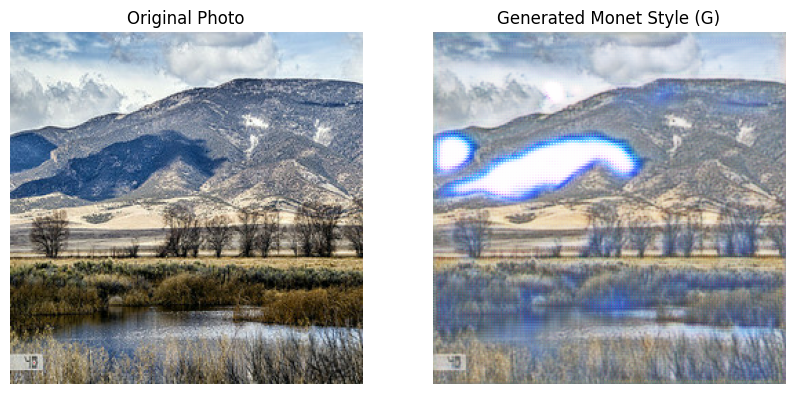

In [104]:
photo_sample = next(iter(photo_images.take(1)))        
photo_sample = (photo_sample - 0.5) * 2  # Normalize to [-1, 1]
generate_and_save_images(G_3, photo_sample, -1)

Frankly speaking, our model did learn monet texture and color pattern. The lower part of the generated painting looks pretty good. But our model seems to not handle shadows very well. Let's submit this model for now.

In [105]:
G_final = G_3

In [ ]:
import shutil
if os.path.exists(f'{out_dir}/imgs'):
    shutil.rmtree(f'{out_dir}/imgs')
os.makedirs(f'{out_dir}/imgs')

n=1
for img in photo_images:
    pred = (G_final(img, training=False)[0].numpy().squeeze() * 255).astype(np.uint8)
    tf.keras.utils.save_img(f'{out_dir}/imgs/{n}.jpg', pred)
    n += 1    


In [108]:
shutil.make_archive(f'{out_dir}/images', 'zip', f'{out_dir}/imgs')
shutil.rmtree(f'{out_dir}/imgs')

 # Conclusion

In this notebook, we extract data from tfrec collections and inspect some of it. We also try to explore some patterns in the data, like different color schemes of Monet dataset and photo dataset, and edges distributions of two datasets.

Then we build our cycleGAN. Define generator architecture(ResNet), discriminator architecture(patchGAN), all three types of losses(adversarial loss, cycle consistency loss and identity loss), train step and train loop.

Finally we tune different learning rates and epochs to find a better solution.

The key takeaway of this notebook is ResNet generators + patchGAN + 3 losses cycleGAN architecture did give us a relativly good model to transfer photos to monet painting. This model eventually gives us a score of 93.8.

In the future, I can do more decent hyperparameter tuning, like beta_1 tuning for adam, and add some checkpoints in the training.

# Reference

* https://blog.keras.io/building-autoencoders-in-keras.html
* https://en.wikipedia.org/wiki/Generative_adversarial_network
* https://github.com/junyanz/CycleGAN
* https://machinelearningmastery.com/what-is-cyclegan/
* https://www.youtube.com/watch?v=4LktBHGCNfw
* https://www.kaggle.com/code/josephleakakos/mo-monet-mo-problems